In [58]:
import os

import utils.utils as utils
import utils.visualization_utils as visualization

import numpy as np
import pandas as pd
import seaborn as sns
import IPython.display as ipd
import matplotlib.pyplot as plt

from pca import pca
from dotenv import load_dotenv
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

sns.set_palette("Set2")
load_dotenv()

True

In [2]:
tracks = pd.read_csv(os.getenv('TRACKS_PATH_PROCESSED'), index_col=0)
df = pd.read_csv(os.getenv('FEATURES_PATH'), index_col=0, header=[0, 1, 2])
df.head()

feature    chroma_cens                                                    \
statistics    kurtosis                                                     
number              01        02        03        04        05        06   
track_id                                                                   
2             7.180653  5.230309  0.249321  1.347620  1.482478  0.531371   
3             1.888963  0.760539  0.345297  2.295201  1.654031  0.067592   
5             0.527563 -0.077654 -0.279610  0.685883  1.937570  0.880839   
10            3.702245 -0.291193  2.196742 -0.234449  1.367364  0.998411   
20           -0.193837 -0.198527  0.201546  0.258556  0.775204  0.084794   

feature                                             ...   tonnetz            \
statistics                                          ...       std             
number            07        08        09        10  ...        04        05   
track_id                                            ...                       
2           1.481593  2.691455  0.866868  1.341231  ...  0.054125  0.012226   
3           1.366848  1.054094  0.108103  0.619185  ...  0.063831  0.014212   
5          -0.923192 -0.927232  0.666617  1.038546  ...  0.040730  0.012691   
10          1.770694  1.604566  0.521217  1.982386  ...  0.074358  0.017952   
20         -0.289294 -0.816410  0.043851 -0.804761  ...  0.095003  0.022492   

feature                     zcr                                          \
statistics             kurtosis       max      mean    median       min   
number            06         01        01        01        01        01   
track_id                                                                  
2           0.012111   5.758890  0.459473  0.085629  0.071289  0.000000   
3           0.017740   2.824694  0.466309  0.084578  0.063965  0.000000   
5           0.014759   6.808415  0.375000  0.053114  0.041504  0.000000   
10          0.013921  21.434212  0.452148  0.077515  0.071777  0.000000   
20          0.021355  16.669037  0.469727  0.047225  0.040039  0.000977   

feature                         
statistics      skew       std  
number            01        01  
track_id                        
2           2.089872  0.061448  
3           1.716724  0.069330  
5           2.193303  0.044861  
10          3.542325  0.040800  
20          3.189831  0.030993  

[5 rows x 518 columns]

In [3]:
print(f'For each of the features, the following descriptive statistics are calculated: {list(df.columns.get_level_values(1).unique())}\n')
for c in list(df.columns.get_level_values(0).unique()):
    print(f'- {c}:')
    # print(f'     df: {list(df[c].columns.get_level_values(0).unique())}')
    num_values = len(df[c].columns.get_level_values(1).unique())
    print(f'     number of values measured: {num_values} (total: {num_values} * {7} = {num_values * 7})')

For each of the features, the following descriptive statistics are calculated: ['kurtosis', 'max', 'mean', 'median', 'min', 'skew', 'std']

- chroma_cens:
     number of values measured: 12 (total: 12 * 7 = 84)
- chroma_cqt:
     number of values measured: 12 (total: 12 * 7 = 84)
- chroma_stft:
     number of values measured: 12 (total: 12 * 7 = 84)
- mfcc:
     number of values measured: 20 (total: 20 * 7 = 140)
- rmse:
     number of values measured: 1 (total: 1 * 7 = 7)
- spectral_bandwidth:
     number of values measured: 1 (total: 1 * 7 = 7)
- spectral_centroid:
     number of values measured: 1 (total: 1 * 7 = 7)
- spectral_contrast:
     number of values measured: 7 (total: 7 * 7 = 49)
- spectral_rolloff:
     number of values measured: 1 (total: 1 * 7 = 7)
- tonnetz:
     number of values measured: 6 (total: 6 * 7 = 42)
- zcr:
     number of values measured: 1 (total: 1 * 7 = 7)


In [4]:
tracks_genre_top = tracks[['genre_top']]
tracks_genre_top.columns = pd.MultiIndex.from_tuples([('genre','','')])
df = pd.merge(df, tracks_genre_top, left_index=True, right_index=True, validate='1:1')
df = df.sort_index(axis=1)

# 1. Missing values and duplicates

In [5]:
df.isna().sum().sum()

0

There are tracks that have duplicate audio features, but differences in the metadata. However, since our primary objective is genre classification, we don't need to investigate the reason behind the metadata differences. It's worth noting that many of the duplicate songs were added by the same author but at different dates or times.
Therefore, we can keep only one copy of the duplicate tracks, because their features are identical

In [6]:
duplicates_mask = df.duplicated()
indexes_duplicated = df[duplicates_mask].index
bool_values = []
for song_title in tracks.loc[indexes_duplicated, 'track_title']:
    bool_values.append(tracks[tracks['track_title'] == song_title]['artist_id'].nunique() == 1)
print(f'{np.sum(bool_values)} of {duplicates_mask.sum()} duplicate songs are songs that were added by the same artist.')

195 of 223 duplicate songs are songs that were added by the same artist.


In [7]:
df.drop_duplicates(inplace=True)

# 2. Exploring the features

## 2.1 Spectral Features

### 2.1.1 MFCC

The mel frequency cepstral coefficients (MFCCs) of a signal are a small set of features (20 in our case) which concisely describe the overall shape of a spectral envelope.
In short, MFCCs are extracted from a sound by dividing it into frames, applying a logarithmic transformation of frequency, computing the power spectrum and Discrete Cosine Transform, and normalizing the resulting coefficients. The result after performing MFCC on a given audio signal is a matrix with C rows and F columns, where C is the number of coefficients (in our case 20) and F is the number of frames (unknown in our case). Finally, summary statistics are computed for each of the 20 coefficients.

MFCCs are highly discriminative features as they describe the overall shape of the spectral envelope.
In order to better understand the data, I used PCA to reduce the dimensionality of the features to two components and focused on two out of the sixteen genres for visualization purposes. However, when building the models, we will explore the results using different numbers of principal components in the PCA.

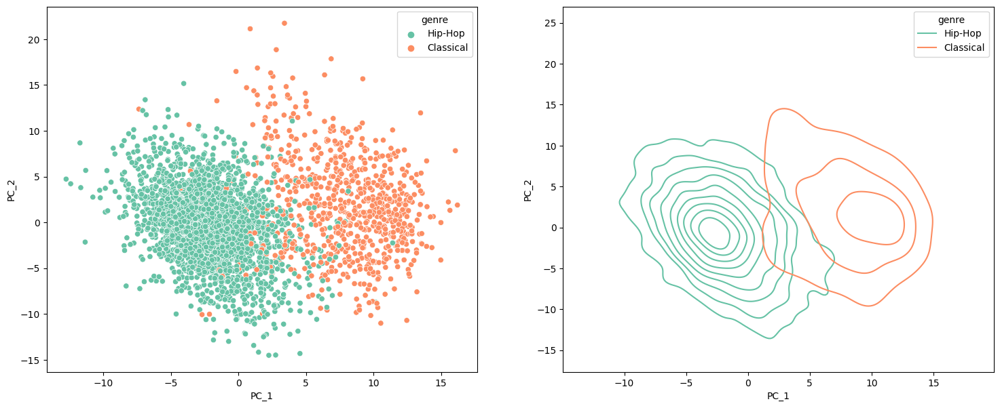

In [8]:
visualization.genre_2d_pca_visualization(df, features=['mfcc'], genres=['Hip-Hop', 'Classical'], n_components=2)

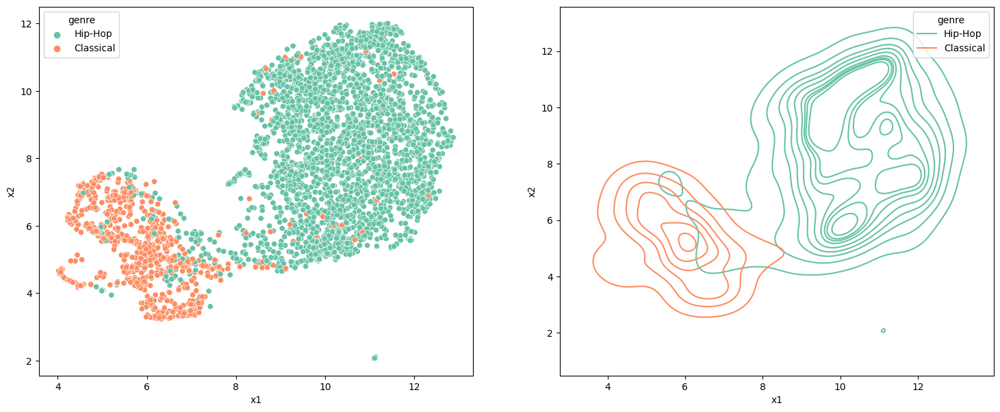

In [9]:
visualization.genre_2d_umap_visualization(df, features=['mfcc'], genres=['Hip-Hop', 'Classical'], n_components=2)

In [10]:
mfcc_mean = df[('mfcc', 'mean')].copy()

The absence of a strong monotonic relationship between the means of the mfcc coefficients suggests that there is probably no redundancy among these features.

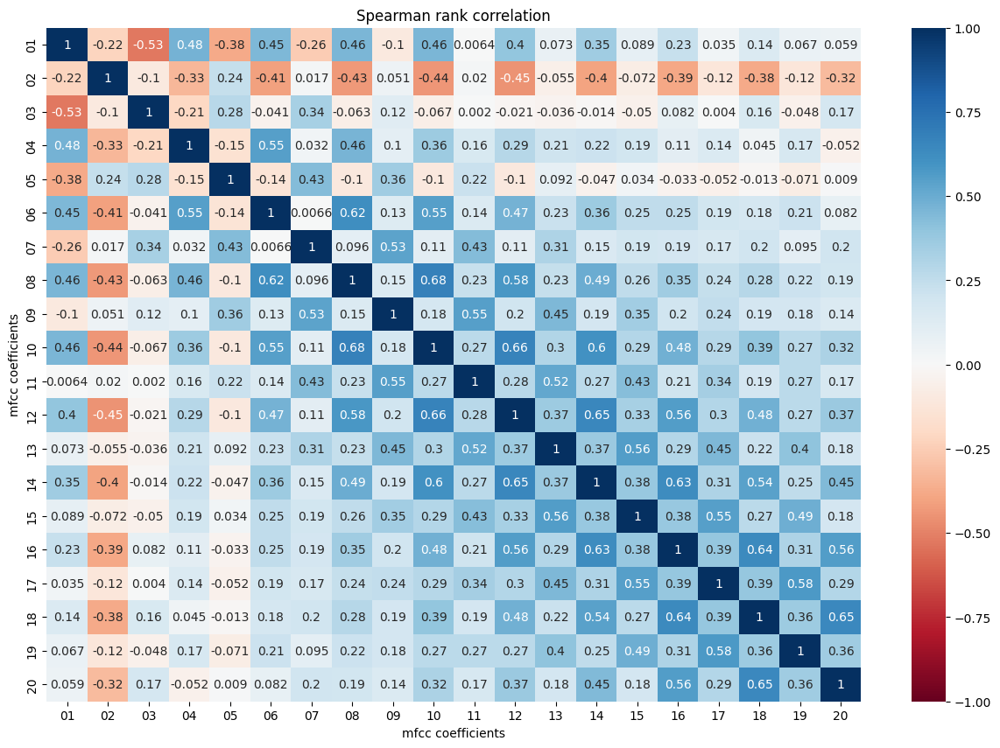

In [11]:
visualization.corr_heatmap(mfcc_mean, axis_label='mfcc coefficients', title='Spearman rank correlation', method='spearman', figsize=(15, 10))

### 2.1.2 ZCR

The zero crossing rate (ZCR) measures how many times the waveform crosses the zero axis. In other words, it is the number of times the signal changes value, from positive to negative and vice versa, divided by the length of the frame.
ZCR can be interpreted as a <b>measure of the noisiness</b> of a signal. For example, it usually exhibits higher values in the case of noisy signals.
Let's investigate whether there is a relationship between the genre of a track and its zero-crossing rate (ZCR), as genres like experimental and rock music may exhibit higher levels of noise in their waveforms.

In [12]:
zcr_df = df['zcr'].copy()
zcr_df['genre'] = df['genre'].copy()

To begin our analysis, we will use the median of the ZCR as it provides a better statistic for the distributions, particularly since they appear to be right-skewed.

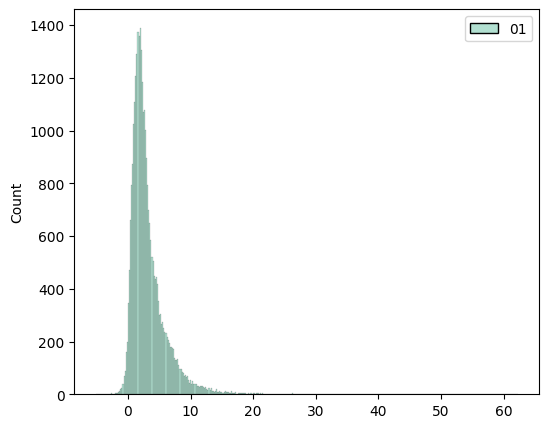

In [13]:
plt.figure(figsize=(6, 5))
sns.histplot(df['zcr', 'skew'])
plt.show()

Although the median of the ZCR alone may not appear to be a distinguishing feature, there are noticeable differences in the plotted data. While a statistical test could be performed to compare the medians of each ZCR feature across different genres, for now, we will assume that this feature, in combination with other features, could potentially be significant.

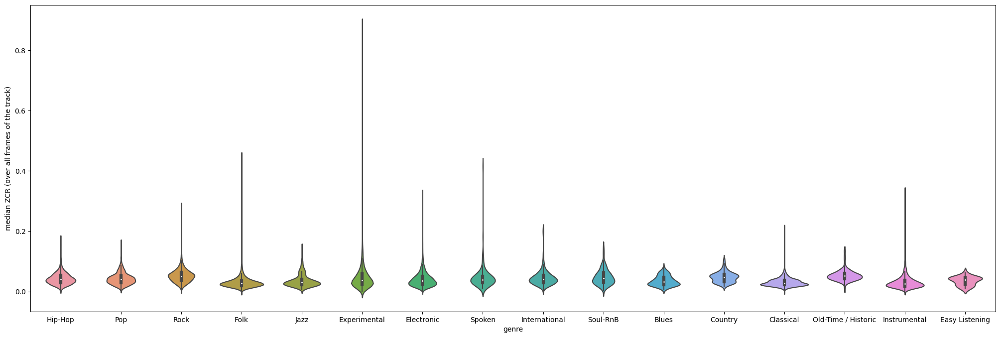

In [14]:
plt.figure(figsize=(25, 8))
sns.violinplot(data=zcr_df[['median', 'genre']], y=('median', '01'), x=('genre', ''))
plt.ylabel('median ZCR (over all frames of the track)')
plt.xlabel('genre')
plt.show()

### 2.1.3 Spectral Contrast

Octave based Spectral Contrast feature is proposed to represent the spectral characteristics of a music clip. It represented the relative spectral distribution instead of average spectral envelope (represented by MFCC).
Octave-based Spectral Contrast feature considers the strength of spectral peaks and spectral valleys in each sub-band separately, so that it could represent the relative spectral characteristics, and then roughly reflect the distribution of harmonic and non-harmonic components. Experiments had shown that Octave-based Spectral Contrast feature had good discrimination in music type classification and performed better than MFCC feature.
Source: https://hcsi.cs.tsinghua.edu.cn/Paper/Paper02/200218.pdf


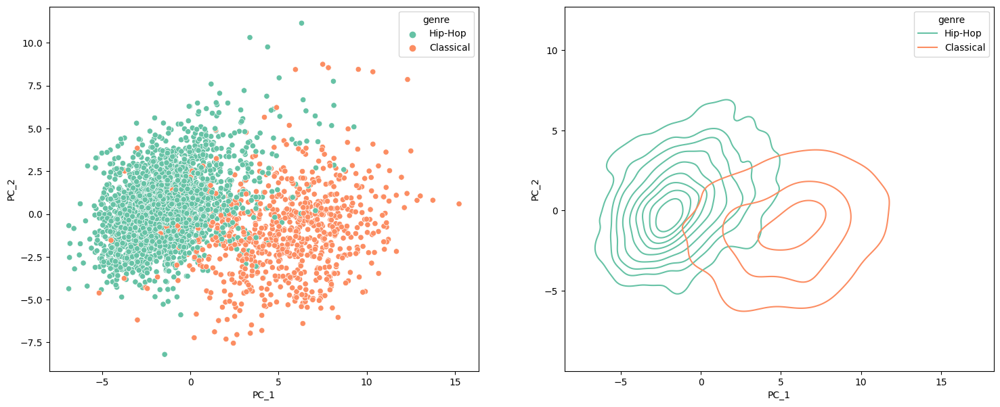

In [15]:
visualization.genre_2d_pca_visualization(df, features=['spectral_contrast'], genres=['Hip-Hop', 'Classical'], n_components=2)

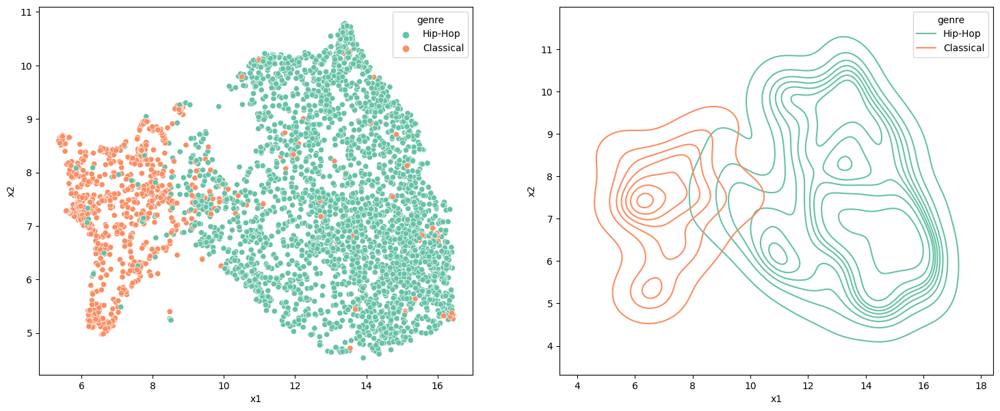

In [16]:
visualization.genre_2d_umap_visualization(df, features=['spectral_contrast'], genres=['Hip-Hop', 'Classical'], n_components=2)

### 2.1.4 Spectral Centroid, Bandwidth & Rolloff
Deeper explanation of the following features: https://musicinformationretrieval.com/spectral_features.html
1. <b>Spectral Centroid:</b> Measure of the center of gravity of the power spectrum of a sound signal. It is calculated as the weighted mean of the frequencies present in the signal, determined using a Fourier transform, with their magnitudes as the weights. The spectral centroid is often used to describe the brightness or tonal character of a sound, with higher values indicating a "brighter" sound.
2. <b>Spectral Bandwidth:</b> Measure of the spread of frequencies in a signal. It is often used to describe the clarity or sharpness of a sound, with higher values indicating a broader range of frequencies.
3. <b>Spectral Contrast:</b> Measure of the difference in magnitude between spectral peaks and valleys in a signal. It is often used to describe the timbre or texture of a sound, with higher values indicating a greater contrast between spectral peaks and valleys (7 coefficients per track).
4. <b>Spectral Rolloff:</b> Measure of the frequency below which a specified percentage of the total spectral energy of a signal is contained. It is often used to describe the overall brightness or energy distribution of a sound, with higher values indicating a greater proportion of high-frequency content.

In [17]:
spectral_features = df[[('spectral_rolloff', 'mean', '01'), ('spectral_centroid', 'mean', '01'), ('spectral_bandwidth', 'mean', '01')]].droplevel([1,2], axis=1)
spectral_features.columns = [f'(mean) {col}' for col in spectral_features.columns]

d:\Kiril\Da Finki\6 Semestar\Податочно Рударење\PR_Labs\clone\Music-Genre-Classification\.venv\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 1500x800 with 0 Axes>

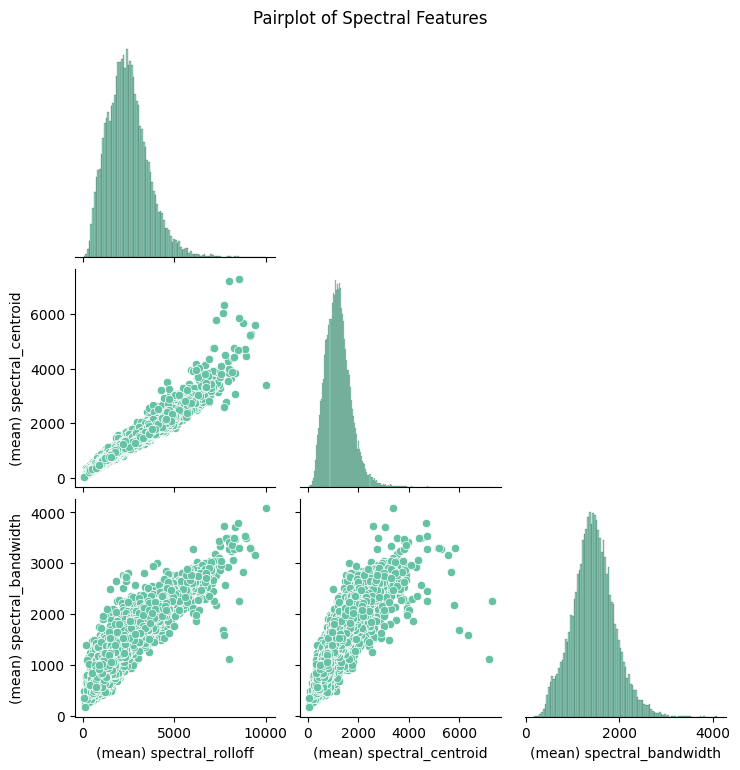

In [18]:
plt.figure(figsize=(15, 8))
sns.pairplot(spectral_features, corner=True)
plt.suptitle("Pairplot of Spectral Features", y=1.02)  # Add the title above the plot
plt.show()

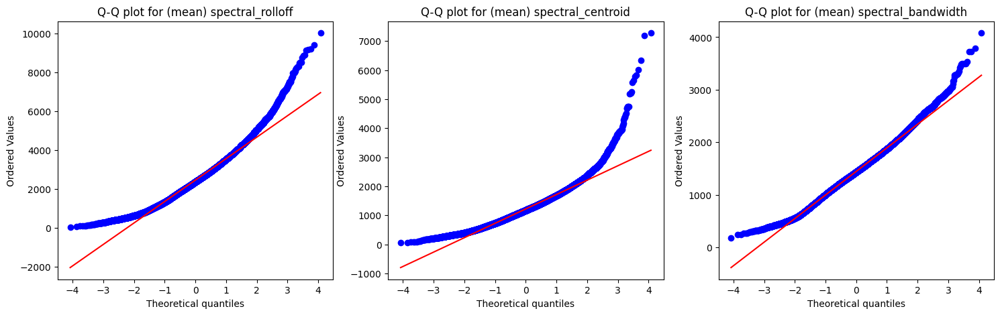

In [19]:
visualization.plot_qq(spectral_features, figsize=(18, 5))

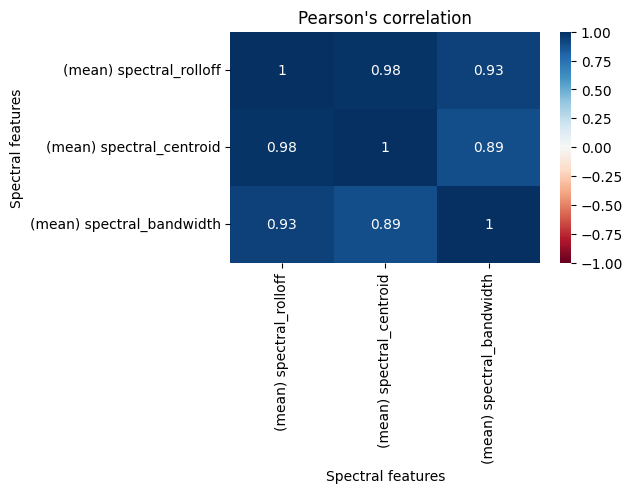

In [20]:
visualization.corr_heatmap(spectral_features, axis_label='Spectral features', title="Pearson's correlation", method='pearson', figsize=(5, 3))

Due to the strong linear correlation among these features, it is possible that we may need to eliminate some of them during the model training process.

## 2.2 Chroma Features

### 2.2.1 Chroma Cens, Cqt, Stft
Chroma features are based on the analysis of the pitch content of an audio signal. They are designed to capture information about the musical harmony and tonality of a sound, and are particularly useful for tasks such as chord recognition and key detection. Chroma features are typically calculated by first converting the audio signal into a sequence of chroma vectors, where each vector represents the amount of energy in each of the 12 chroma classes (corresponding to the 12 notes of the Western musical scale - C, C#, D, D#, E, F, F#, G, G#, A, A#, B) over a short time window.
These features are robust to variations in instrumentation, timbre or dynamics, meaning that they can capture the harmonic content of music across different genres, styles, or performances. This is because they only consider the pitch class of the notes, <b>regardless of their octave or frequency</b>, and therefore are <b>less sensitive to the specific timbre</b> or tone of each note.
In our case, <b>chroma_cens, chroma_cqt,</b> and <b>chroma_stft</b> are all variants of the chroma feature, but they differ in how they are computed from the audio signal.

Notebook: https://colab.research.google.com/github/stevetjoa/musicinformationretrieval.com/blob/gh-pages/chroma.ipynb#scrollTo=EO0eJaG7UW9L

The chroma features, including chroma_cqt, chroma_stft, and chroma_cqt, exhibit maximum values of predominantly 1 and minimum values of predominantly 0 for each chroma class. It may be beneficial to drop these features while constructing the ML models, as it could significantly reduce the dimensionality by 36 dimensions.

In [21]:
df.loc[:,pd.IndexSlice['chroma_cqt',['max', 'min']]].head(3)

chroma_cqt                                               ...       \
                max                                               ...  min   
                 01   02   03   04   05   06   07   08   09   10  ...   03   
track_id                                                          ...        
2               1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  ...  0.0   
3               1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  ...  0.0   
5               1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  ...  0.0   

                                                       
                                                       
           04   05   06   07   08   09   10   11   12  
track_id                                               
2         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
3         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
5         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[3 rows x 24 columns]

C:\Users\User\AppData\Local\Temp\ipykernel_18344\450874717.py:2: UserWarning:

To output multiple subplots, the figure containing the passed axes is being cleared.



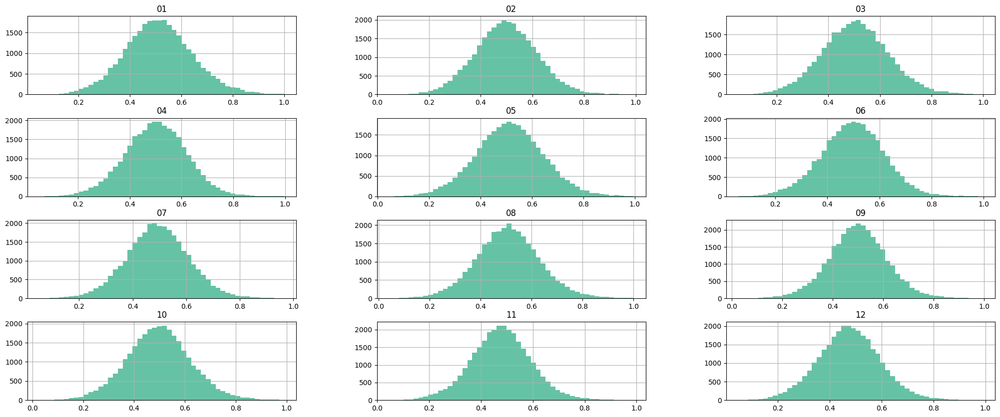

In [22]:
ax = plt.figure(figsize=(25, 10))
df['chroma_cqt', 'mean'].hist(ax=ax, bins=50)
plt.show()

Since the chroma CQT features represent the 12 distinct pitch classes in Western music, it is expected that the chroma features for adjacent notes will be highly correlated.
However, we can also observe "clusters" of features that are strongly correlated, indicating the presence of a melody that is centered around those notes. While these features alone may not be sufficient to differentiate between genres, when combined with other features they can provide valuable insights into the musical structure of the audio signal.

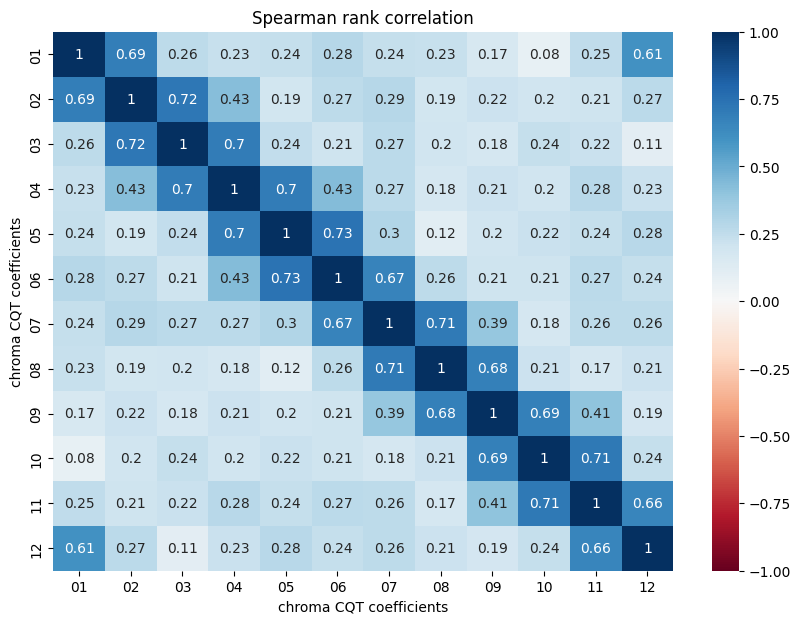

In [23]:
visualization.corr_heatmap(df['chroma_cqt', 'mean'], axis_label='chroma CQT coefficients', title='Spearman rank correlation', method='spearman', figsize=(10, 7))

### 2.2.2 Tonnetz

The tonnetz represents a projection of chroma features onto a 6-dimensional basis, representing the perfect fifth, minor third, and major third (these are intervals) each as two-dimensional coordinates.

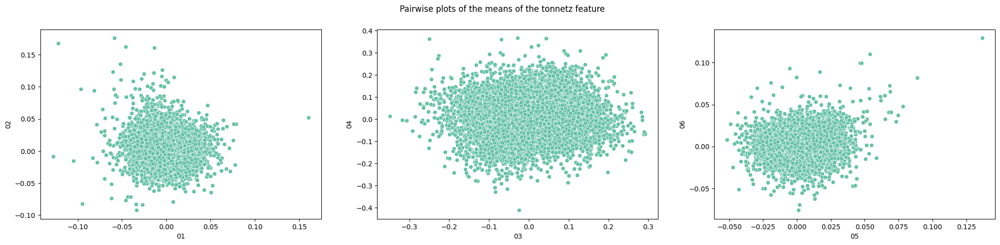

In [24]:
perfect_fifths = ('01', '02')
minor_thirds = ('03', '04')
major_thirds = ('05', '06')

fig, axs = plt.subplots(1, 3, figsize=(25, 5))
fig.suptitle('Pairwise plots of the means of the tonnetz feature')
for ax_idx, components in enumerate([perfect_fifths, minor_thirds, major_thirds]):
    sns.scatterplot(data=df['tonnetz', 'mean'][list(components)], x=components[0], y=components[1], ax=axs[ax_idx])

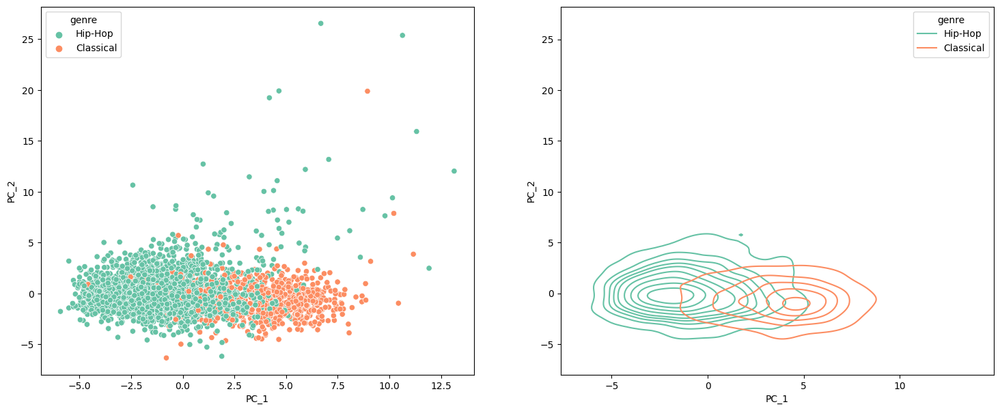

In [25]:
visualization.genre_2d_pca_visualization(df, features=['tonnetz'], genres=['Hip-Hop', 'Classical'], n_components=2)

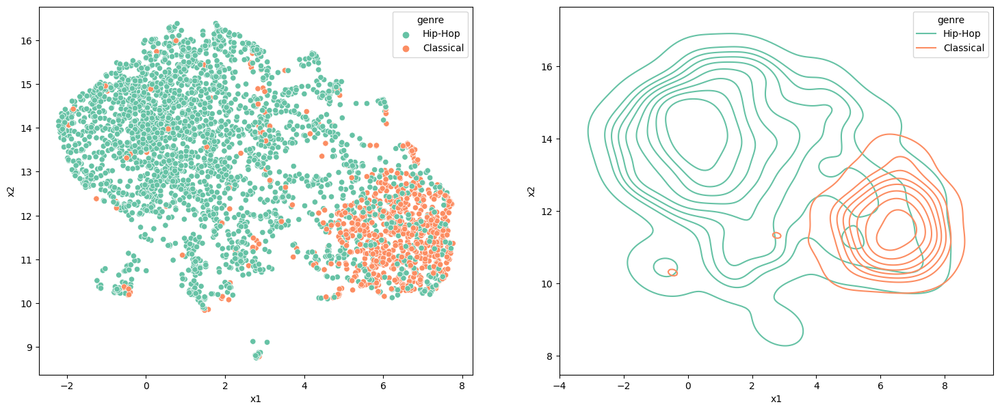

In [26]:
visualization.genre_2d_umap_visualization(df, features=['tonnetz'], genres=['Hip-Hop', 'Classical'], n_components=2)

## 2.3 RMS
The energy of a signal corresponds to the total magnitude of the signal. For audio signals, that roughly corresponds to how loud the signal is (although it is worth noting that the RMS energy does not necessarily correspond directly to the perceived loudness of the audio signal).

In [27]:
rmse = df['rmse'].T.reset_index(level=[0,1], drop=True).T
rmse.columns = df['rmse'].columns.get_level_values(0)

C:\Users\User\AppData\Local\Temp\ipykernel_18344\1466626883.py:2: UserWarning:

To output multiple subplots, the figure containing the passed axes is being cleared.



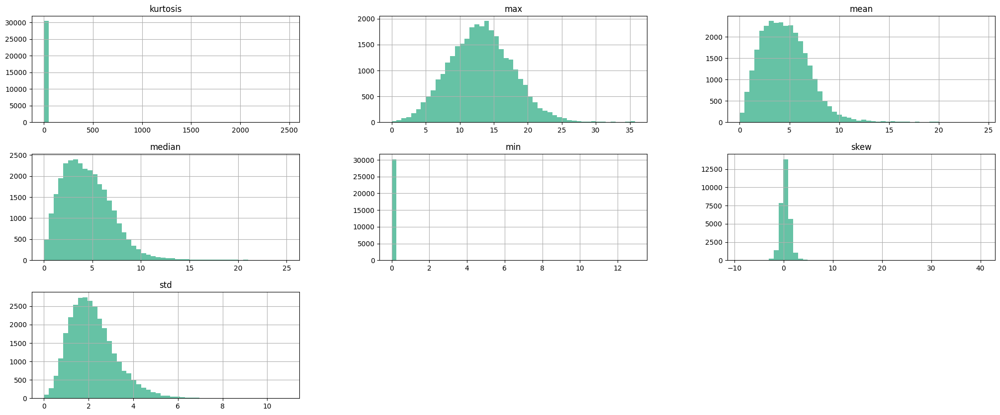

In [28]:
ax = plt.figure(figsize=(25, 10))
rmse.hist(ax=ax, bins=50)
plt.show()

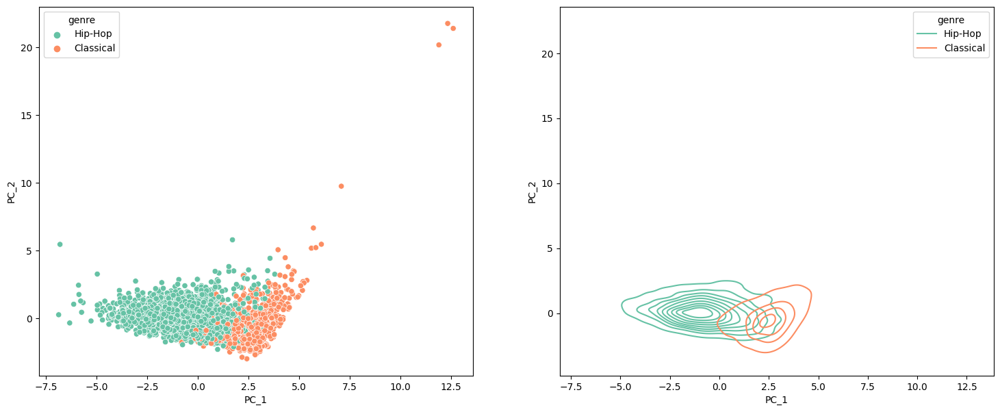

In [29]:
visualization.genre_2d_pca_visualization(df, features=['rmse'], genres=['Hip-Hop', 'Classical'], n_components=2)

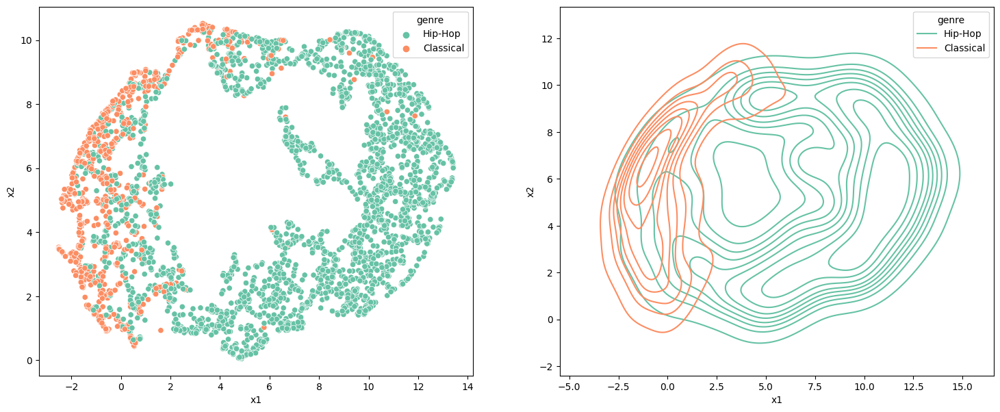

In [30]:
visualization.genre_2d_umap_visualization(df, features=['rmse'], genres=['Hip-Hop', 'Classical'], n_components=2)

## 2.4 UMAP (Uniform Manifold Approximation & Projection) Plots

We will use a subset of the features for visualization, according to the conclusions drawn above.

In [31]:
# We select only spectral_centroid because of the high correlation with spectral_bandwidth and spectral_rolloff
slice_1 = pd.IndexSlice[['mfcc', 'spectral_centroid', 'spectral_contrast', 'rmse', 'tonnetz', 'zcr', 'genre']]

# Select all features of chroma_cqt, except max (most of the values are 1s)
slice_2 = pd.IndexSlice['chroma_cqt', ('kurtosis', 'mean', 'median', 'min', 'skew', 'std')]
df_reduced_features = pd.concat([df.loc[:, slice_1], df.loc[:, slice_2]], axis=1).copy()

all_features = list(set(df.columns.get_level_values(0).unique()) - {'genre'})

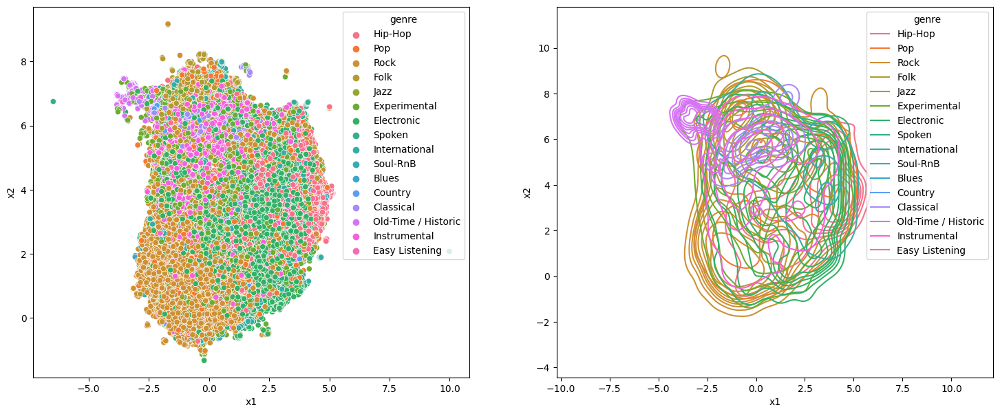

In [32]:
visualization.genre_2d_umap_visualization(df_reduced_features, features=['mfcc', 'spectral_contrast'], genres=df['genre'].unique(), n_components=2, n_neighbors=15, min_dist=0.1, metric='cosine')

In [33]:
visualization.genre_3d_umap_visualization(
    df_reduced_features, 
    label_column='genre', 
    features=['mfcc', 'spectral_contrast'], 
    n_components=3, n_neighbors=100, min_dist=0.2, metric='cosine',
    output_file="spectral_100_02"
)

d:\Kiril\Da Finki\6 Semestar\Податочно Рударење\PR_Labs\clone\Music-Genre-Classification\.venv\Lib\site-packages\plotly\offline\offline.py:562: UserWarning:

Your filename `./plots/spectral_100_02` didn't end with .html. Adding .html to the end of your file.



# 3. Outliers

The PCA library contains two methods for detection of multivariate outliers: Hotelling’s T2 and SPE/DmodX
- Hotelling’s T2 works by analyzing the differences between the data points and the center of the data, and then comparing them to a distribution. If the differences are too extreme, it suggests that the data point is an outlier. Hotelling's T2 can be used to detect outliers across the top 5 components of PCA, and it outputs three columns of data, called: y_proba, y_score, and y_bool.
- SPE/DmodX is another method for detecting outliers in PCA. It looks at the distance between each data point and the model that PCA creates. If a data point is far away from the model, it might be an outlier. SPE/DmodX is based on the mean and covariance of the first 2 dimensions of X, and it outputs two columns of data called: y_bool_spe and y_score_spe (note: the term "model" refers to the representation of the original data set in a lower dimensional space created by PCA).

Source: https://erdogant.github.io/pca/pages/html/Outlier%20detection.html

In [34]:
df_X = df.copy().drop('genre', axis=1).values
pca_model = pca(normalize=True, detect_outliers=['ht2', 'spe'], n_std=3)
pca_results = pca_model.fit_transform(df_X)

[pca] >Column labels are auto-completed.
[pca] >Row labels are auto-completed.
[pca] >Normalizing input data per feature (zero mean and unit variance)..
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [518] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [216] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [518] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[216]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]


(<Figure size 2500x1000 with 1 Axes>,
 <Axes: title={'center': 'Cumulative explained variance\n 216 Principal Components explain [95.07%] of the variance.'}, xlabel='Principle Component', ylabel='Percentage explained variance'>)

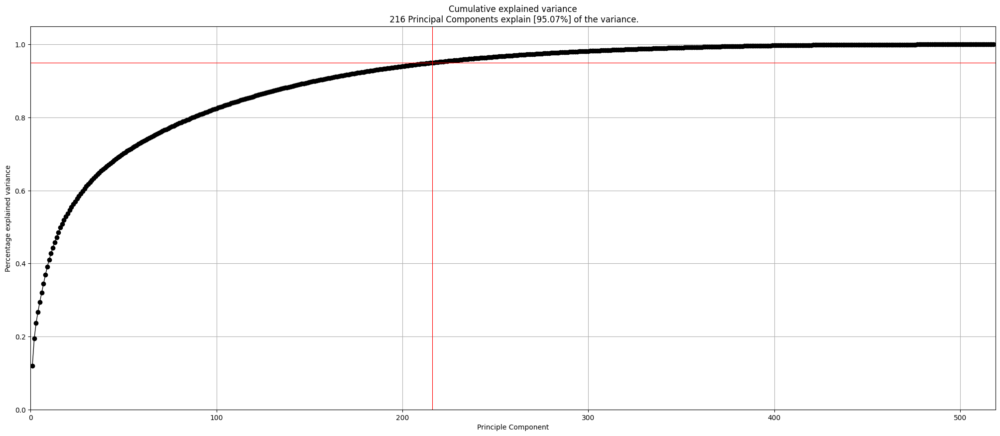

In [35]:
pca_model.plot(figsize=(25, 10))

In [36]:
pca_df = pca_results['PC'][['PC1', 'PC2']].copy()
pca_df.index = df.index
pca_df['genre'] = df['genre']

In [37]:
outliers_hotelling = pd.Series(pca_results['outliers']['y_bool'])
outliers_spe = pd.Series(pca_results['outliers']['y_bool_spe'])

outliers_hotelling.index = df.index
outliers_spe.index = df.index

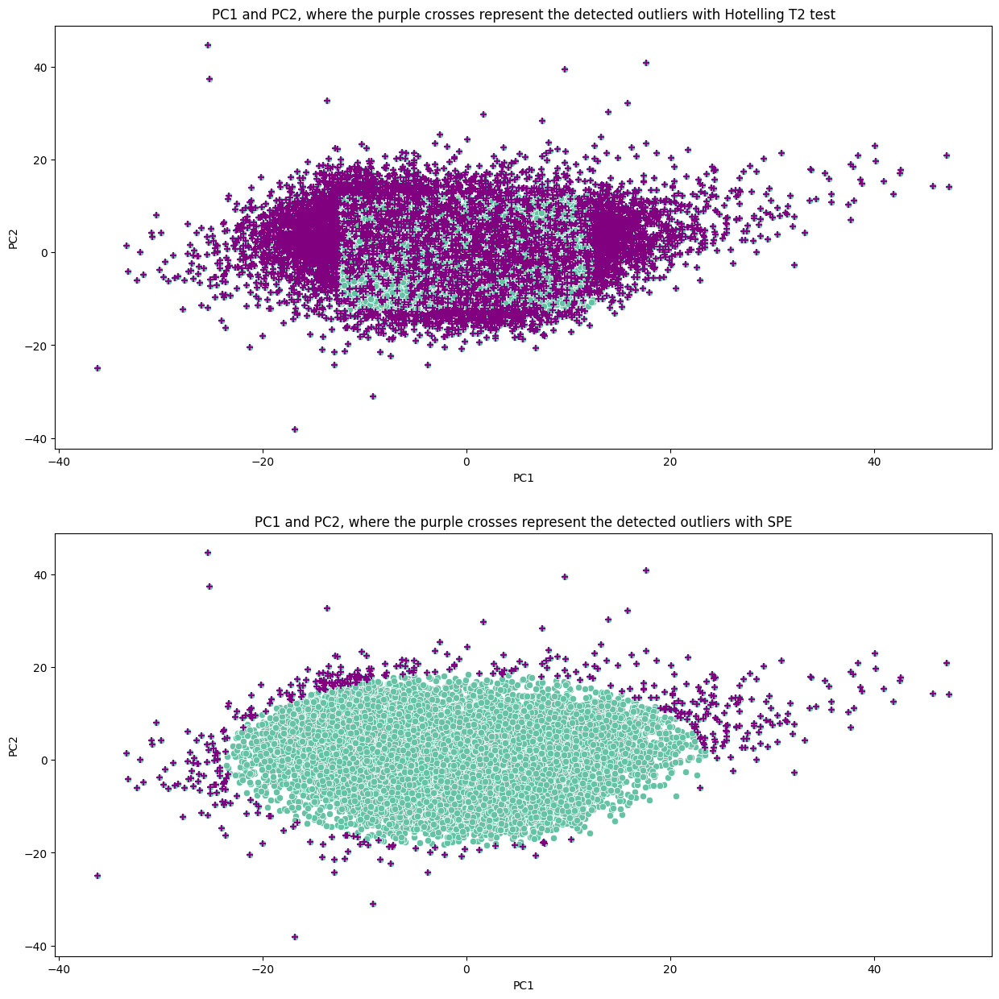

In [38]:
fig, axs = plt.subplots(2, 1, figsize=(15, 15))

sns.scatterplot(data=pca_df, x='PC1', y='PC2', ax=axs[0])
axs[0].scatter(pca_df.loc[outliers_hotelling,'PC1'], pca_df.loc[outliers_hotelling,'PC2'], color='purple', marker='+', s=30)
axs[0].set_title('PC1 and PC2, where the purple crosses represent the detected outliers with Hotelling T2 test')

sns.scatterplot(data=pca_df, x='PC1', y='PC2', ax=axs[1])
axs[1].scatter(pca_df.loc[outliers_spe,'PC1'], pca_df.loc[outliers_spe,'PC2'], color='purple', marker='+', s=30)
axs[1].set_title('PC1 and PC2, where the purple crosses represent the detected outliers with SPE')

plt.show()

We notice that the outliers detected using SPE/DmodX are a subset of the outliers detected by Hotelling's T2 test.

In [39]:
outliers_spe_set = set(outliers_spe[outliers_spe == True].index)
outliers_hotelling_set = set(outliers_hotelling[outliers_hotelling == True].index)
outliers_spe_set.issubset(outliers_hotelling_set)

True

## 3.1 Hoteling's T2 test outliers analysis

In [40]:
print(f'Number of detected outliers: {outliers_hotelling.sum()}')

Number of detected outliers: 6077


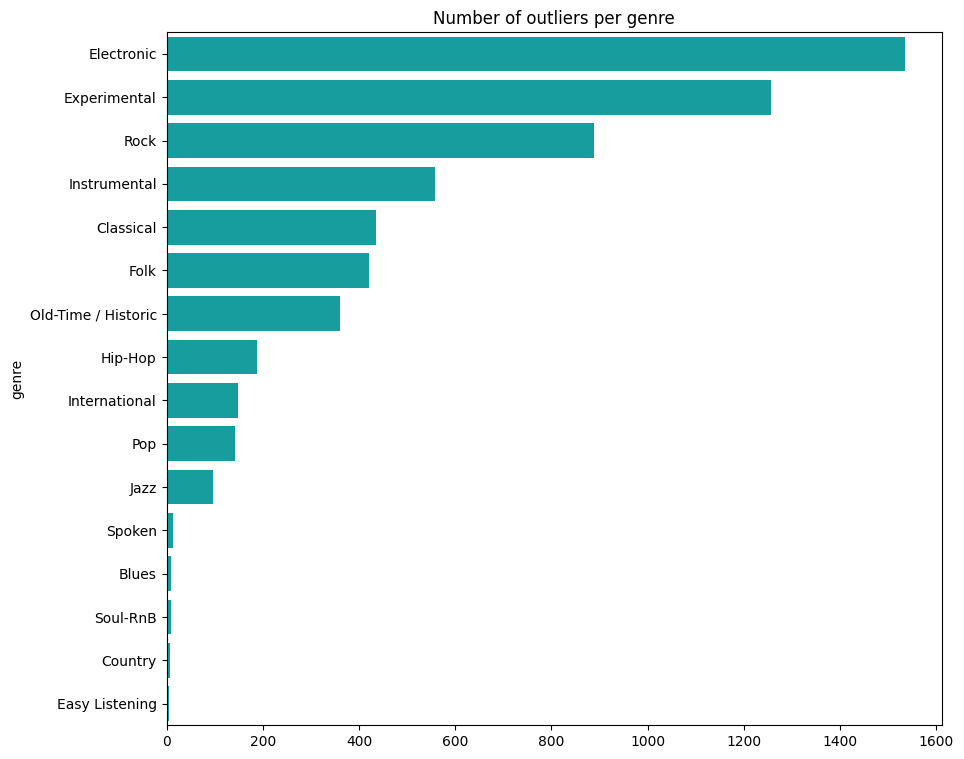

In [41]:
visualization.plot_num_outliers_per_genre(df, outliers_hotelling)

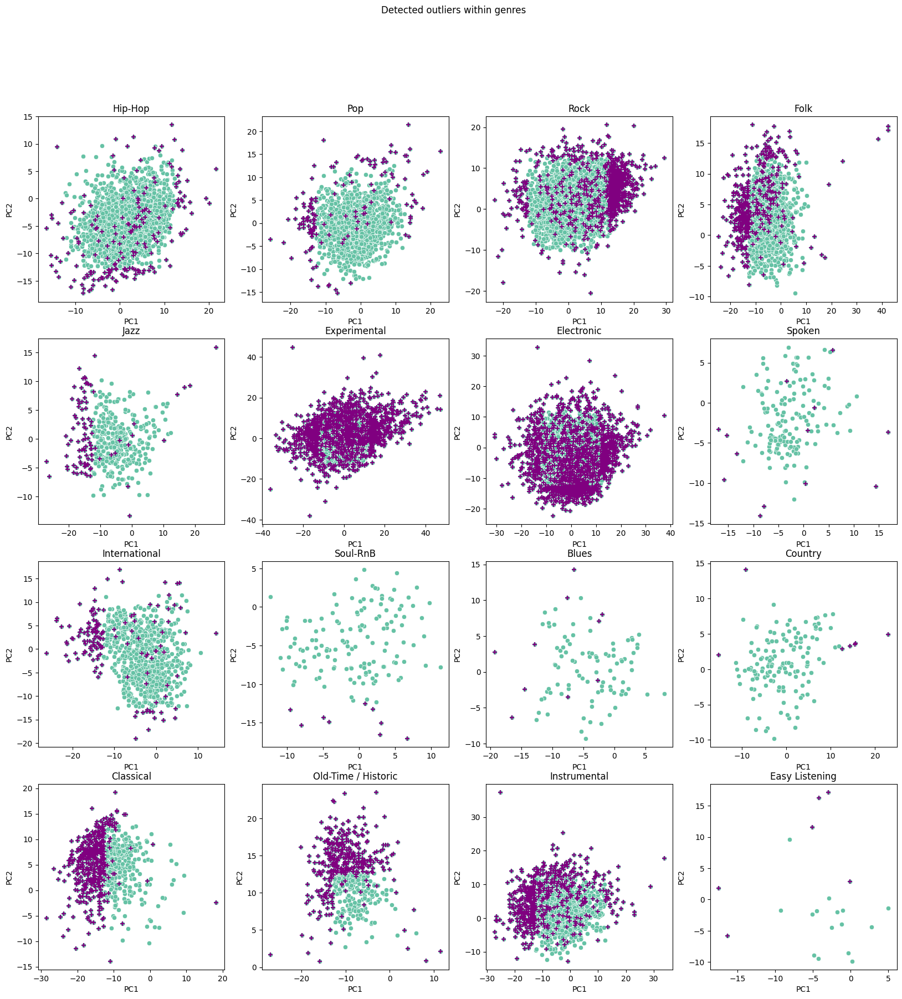

In [42]:
visualization.plot_outliers_per_genre(pca_df, outliers_hotelling)

## 3.2 SPE/DmodX Outliers Analysis

In [43]:
print(f'Number of detected outliers: {outliers_spe.sum()}')

Number of detected outliers: 473


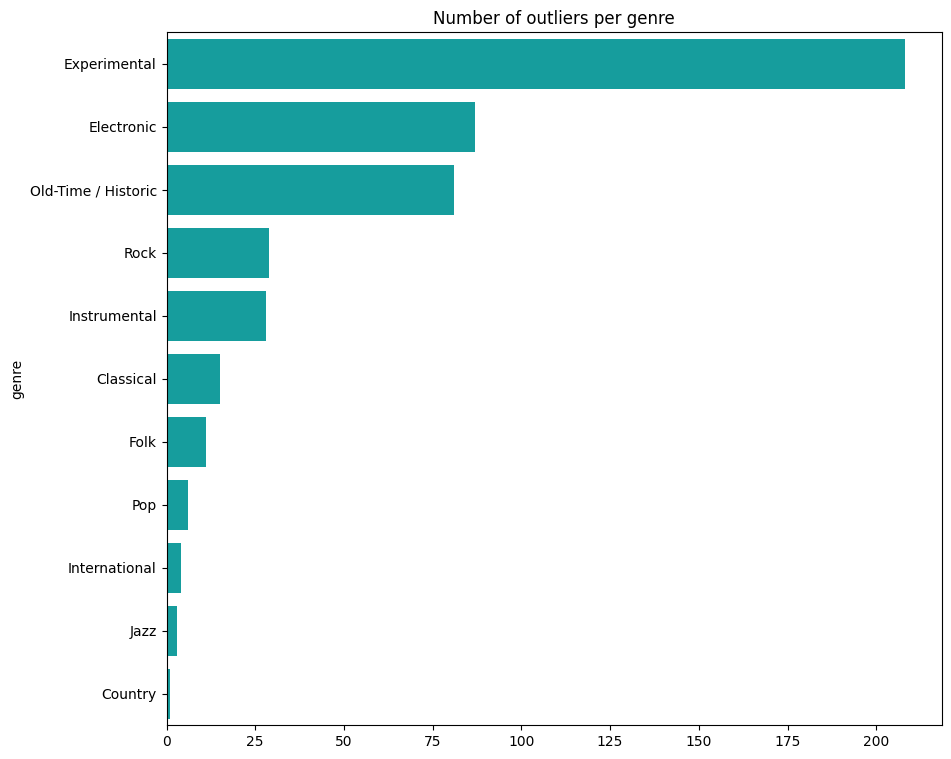

In [44]:
visualization.plot_num_outliers_per_genre(df, outliers_spe)

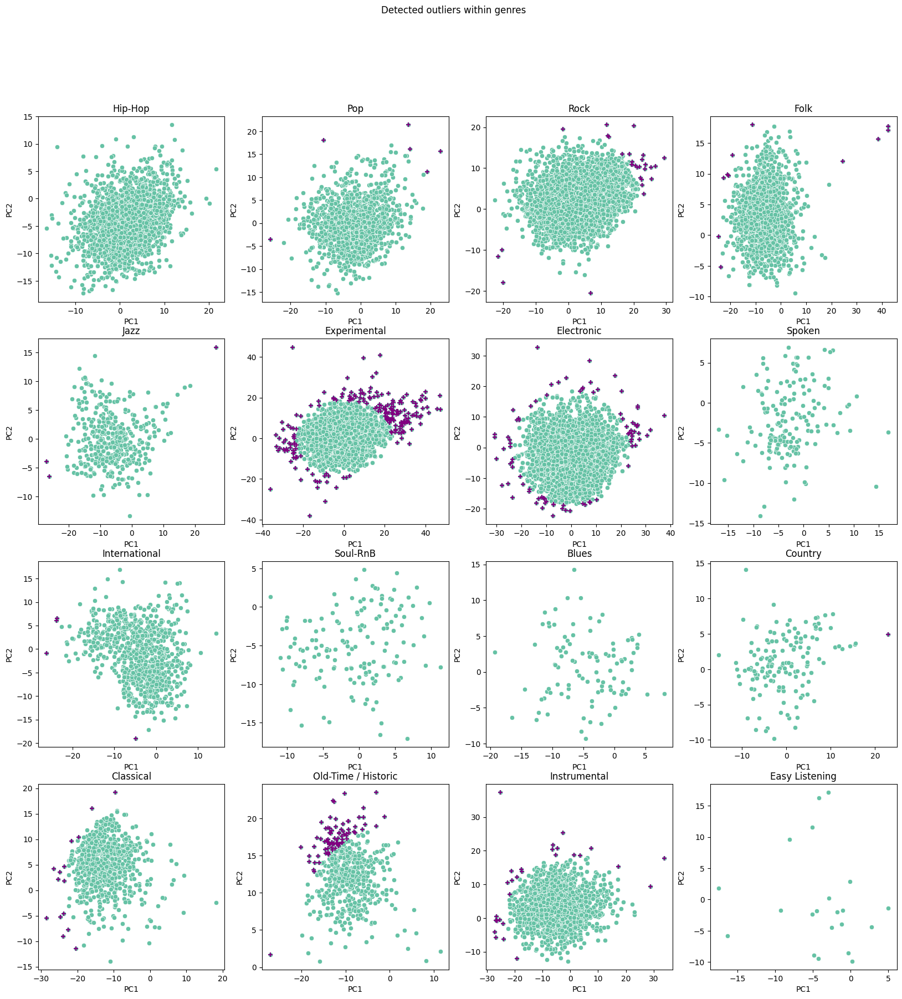

In [45]:
visualization.plot_outliers_per_genre(pca_df, outliers_spe)

## Example Tracks

In [46]:
pca_results_outliers = pca_results['outliers'].copy()
pca_results_outliers.index = df.index

Example of an outlier detected within the "Pop" genre

In [47]:
pop_spe_outliers = pca_df.loc[outliers_spe].query('genre == "Pop"').index
pop_outlier_song_idx = pca_results_outliers.loc[pop_spe_outliers][pca_results_outliers.loc[pop_spe_outliers]['y_score_spe'] == pca_results_outliers.loc[pop_spe_outliers]['y_score_spe'].max()].index
tracks.loc[pop_outlier_song_idx]['track_title']

track_id
150014    Engin n°1
Name: track_title, dtype: object

In [48]:
ipd.Audio('./audio/Urs Graf Consort - Engin n°1.mp3')

In [49]:
df_outliers = df.drop('genre', axis=1, inplace=False).copy()
df_outliers['outlier'] = outliers_spe

In [50]:
visualization.genre_3d_umap_visualization(
    df_outliers, 
    label_column='outlier', 
    features=['mfcc', 'spectral_contrast'], 
    n_components=3, n_neighbors=50, min_dist=0.2, metric='euclidean', 
    output_file="outliers_50_02_euclidean"
)

d:\Kiril\Da Finki\6 Semestar\Податочно Рударење\PR_Labs\clone\Music-Genre-Classification\.venv\Lib\site-packages\plotly\offline\offline.py:562: UserWarning:

Your filename `./plots/outliers_50_02_euclidean` didn't end with .html. Adding .html to the end of your file.



In [51]:
# Removing the outliers
df = df[~outliers_spe]

In [52]:
df.shape

(29962, 519)

# 4. Genre-cluster distances in feature space

Here we try to find out similar genres by assessing how close songs from the respective genres are in a vector space. We first calculate the smilarity between all points from a pair of genres and then we average the results to obtain the genre similarity score. We measure the similarity between two points by using the RBF kernel, instead of using the Euclidean distance, mainly because of the fact that most distances tend to be similar, given the high number of dimensions (curse of dimensionality). By using this kernel, we implicitly map the features in some other abstract space where we measure the similarity. Picking the right value for the parameter $\gamma$ in the RBF kernel is a bit tricky in this scenario since we're not employing the kernel for classification purposes. For this instance, we set $\gamma$ to $\frac{1}{4 \cdot n_{features}}$.

In [53]:
all_features = list(set(df_reduced_features.columns) - {('genre', '', '')})

In [54]:
cluster_similarities = utils.calculate_cluster_similarities(df=df_reduced_features, label='genre', features=all_features)

In [55]:
similarities_df = cluster_similarities.sort_values(by='similarity', ascending=False).copy()
similarities_df['genre'] = cluster_similarities['genre_1'].str.cat(cluster_similarities[f'genre_2'], sep=' <-> ')

Refer back to the 3D visualization of the data along with the accompanying plots

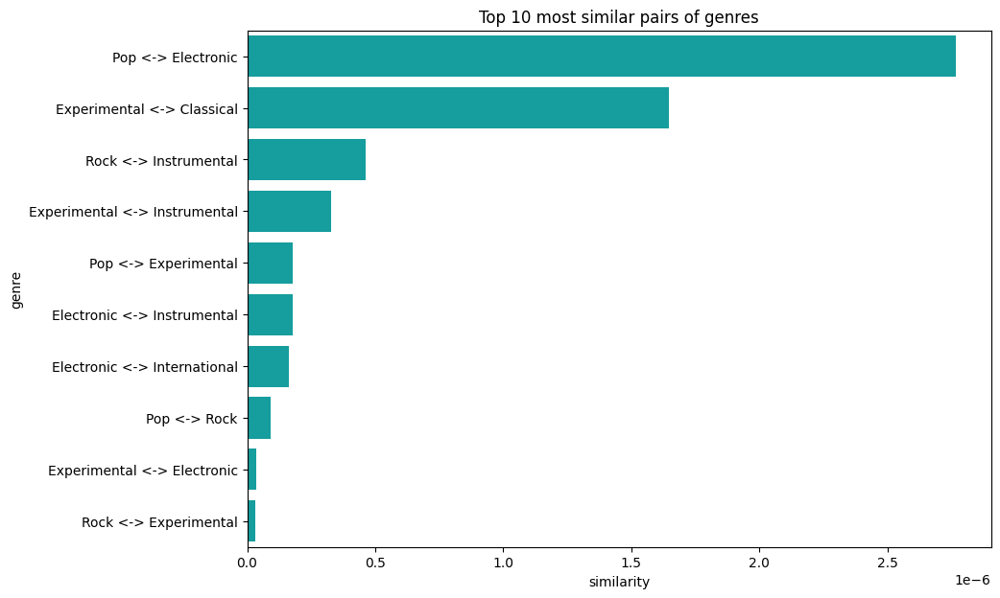

In [56]:
plt.figure(figsize=(10, 7))
sns.barplot(data=similarities_df[:10], x='similarity', y='genre', color='#00B3B3')
plt.title('Top 10 most similar pairs of genres')
plt.show()

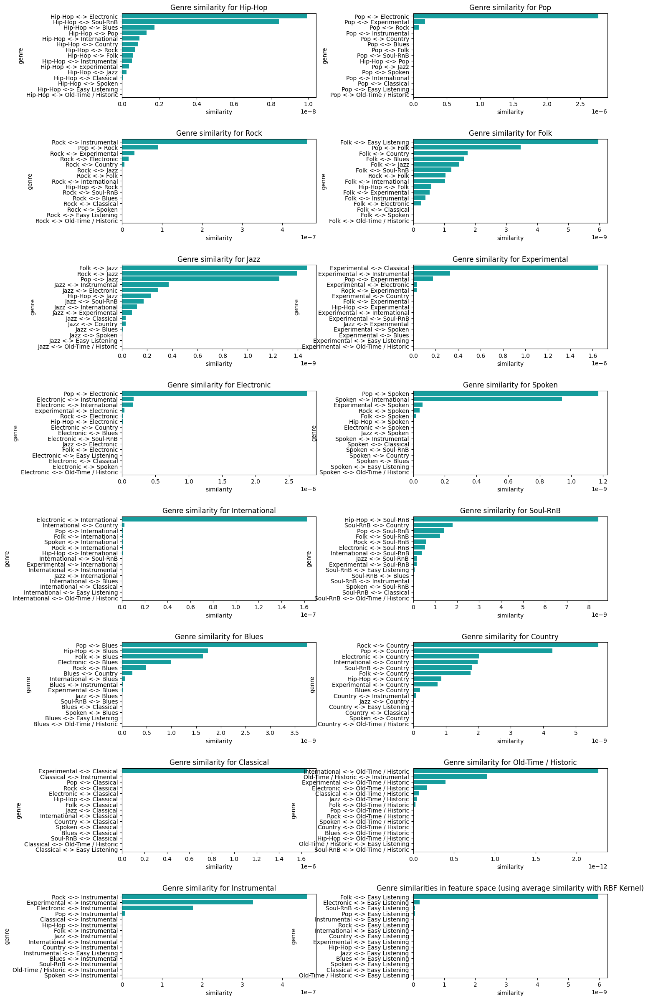

In [59]:
fig, axs = plt.subplots(8, 2, figsize=(15, 30))
axs_idx = [(i, j) for i in range(8) for j in range(2)]
k = 0

for genre in df_reduced_features['genre'].unique():
    i, j = axs_idx[k]
    k += 1
    visualization.plot_cluster_similarities(label='genre', label_value=genre, similarities_df=cluster_similarities, ax=axs[i][j])

plt.subplots_adjust(wspace=0.5, hspace=0.5) 
plt.title('Genre similarities in feature space (using average similarity with RBF Kernel)')
plt.show()

# 5. Train-Test Split

In [60]:
train_set, test_set = train_test_split(df, test_size=0.2, stratify=df['genre'], shuffle=True, random_state=123)
train_set, val_set = train_test_split(train_set, test_size=0.1, stratify=train_set['genre'], shuffle=True, random_state=123)

train_value_counts = train_set['genre'].value_counts(normalize=True) * 100.0
validation_value_counts = val_set['genre'].value_counts(normalize=True) * 100.0
test_value_counts = test_set['genre'].value_counts(normalize=True) * 100.0

train_value_counts.name = 'train %'
validation_value_counts.name = 'validation %'
test_value_counts.name = 'test %'

train_set_indexes = train_set.index
val_set_indexes = val_set.index
test_set_indexes = test_set.index

In [61]:
print(f'     Train set shape: {train_set.shape}')
print(f'Validation set shape: {val_set.shape}')
print(f'      Test set shape: {test_set.shape}')

     Train set shape: (21572, 519)
Validation set shape: (2397, 519)
      Test set shape: (5993, 519)


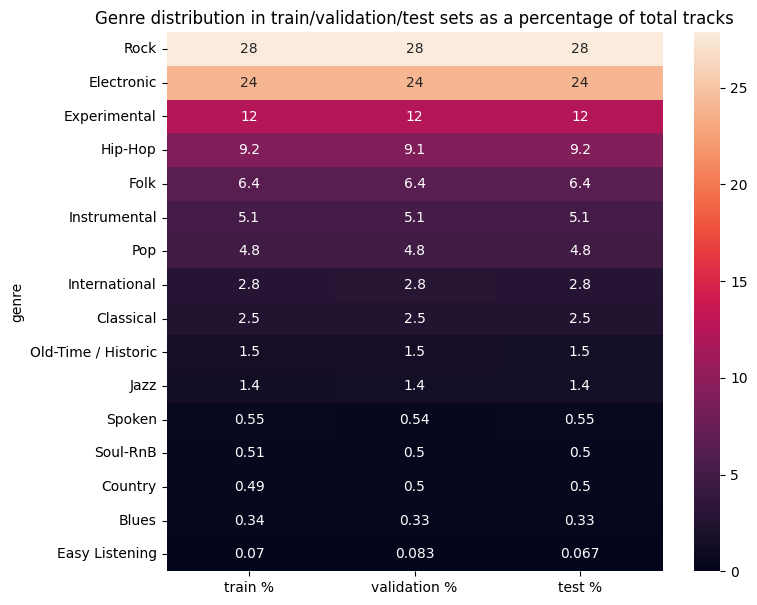

In [62]:
plt.figure(figsize=(8, 7))
sns.heatmap(
    pd.concat([train_value_counts, validation_value_counts, test_value_counts], axis=1),
    annot=True,
    vmin=0
)
plt.title("Genre distribution in train/validation/test sets as a percentage of total tracks")
plt.show()

# 5. Addressing Class Imbalance
When dealing with imbalanced classes, a common technique is to under-sample the majority class(es) and over-sample the minority class(es). The following paper explains that a combination of both over-sampling the minority class and under-sampling the majority class can achieve better classifier performance than only performing one of the two: https://arxiv.org/pdf/1106.1813.pdf.

A common solution for over-sampling is Synthetic Minority Oversampling Technique (SMOTE).
SMOTE first selects a minority class instance $a$ at random and finds its $k$ nearest minority class neighbors. The synthetic instance is then created by choosing one of the $k$ nearest neighbors $b$ at random and connecting $a$ and $b$ to form a line segment in the feature space. The synthetic instances are generated as a convex combination of the two chosen instances $a$ and $b$.
 However, SMOTE doesn't consider the majority class, potentially leading to ambiguous examples in case of **strong class overlap**.

 The under/over-sampling will be performed on the training set only

In [63]:
train_set['genre'].value_counts()

genre
Rock                   6007
Electronic             5187
Experimental           2679
Hip-Hop                1976
Folk                   1380
Instrumental           1101
Pop                    1031
International           609
Classical               545
Old-Time / Historic     329
Jazz                    305
Spoken                  118
Soul-RnB                110
Country                 106
Blues                    74
Easy Listening           15
Name: count, dtype: int64

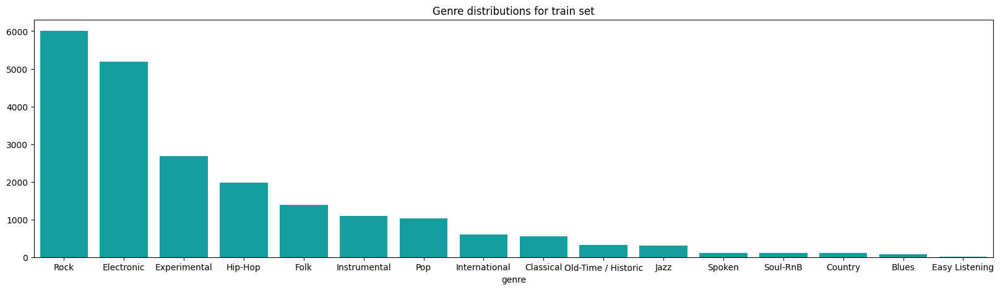

In [64]:
plt.figure(figsize=(20, 5))
sns.barplot(x=train_set['genre'].value_counts().index, y=train_set['genre'].value_counts().values, color='#00B3B3')
plt.title('Genre distributions for train set')
plt.show()

We will perform the undersapling by preserving the most popular songs within the suitable genre, regarding them as more accurate exemplars of the genre itself.

In [65]:
def popularity_score(df, weights):
    df_norm = df.apply(lambda col: col / col.max(), axis=0)
    return df_norm.dot(weights)

tracks_popularity_score = popularity_score(tracks[['track_interest', 'track_listens']], [0.35, 0.65]).to_frame()
tracks_popularity_score.columns = pd.MultiIndex.from_tuples([('popularity_score', '', '')])
train_set = pd.merge(train_set, tracks_popularity_score, left_index=True, right_index=True, validate='1:1')

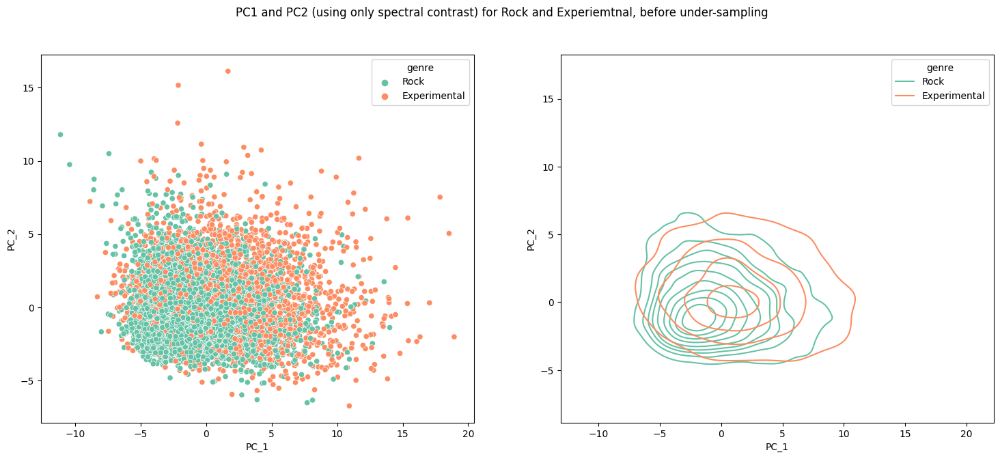

In [66]:
visualization.genre_2d_pca_visualization(train_set, features=['spectral_contrast'], genres=['Rock', 'Experimental'], n_components=2, title='PC1 and PC2 (using only spectral contrast) for Rock and Experiemtnal, before under-sampling')

In [67]:
train_set_modified = train_set.copy()
rock_idxs_drop = train_set_modified[train_set_modified['genre'] == 'Rock'].sort_values(by='popularity_score', ascending=False).iloc[3000:].index
electronic_idxs_drop = train_set_modified[train_set_modified['genre'] == 'Electronic'].sort_values(by='popularity_score', ascending=False).iloc[3000:].index
train_set_modified.drop(rock_idxs_drop, axis=0, inplace=True)
train_set_modified.drop(electronic_idxs_drop, axis=0, inplace=True)

In [68]:
print(f'Shape before: {train_set.shape}, shape after: {train_set_modified.shape}')

Shape before: (21572, 520), shape after: (16378, 520)


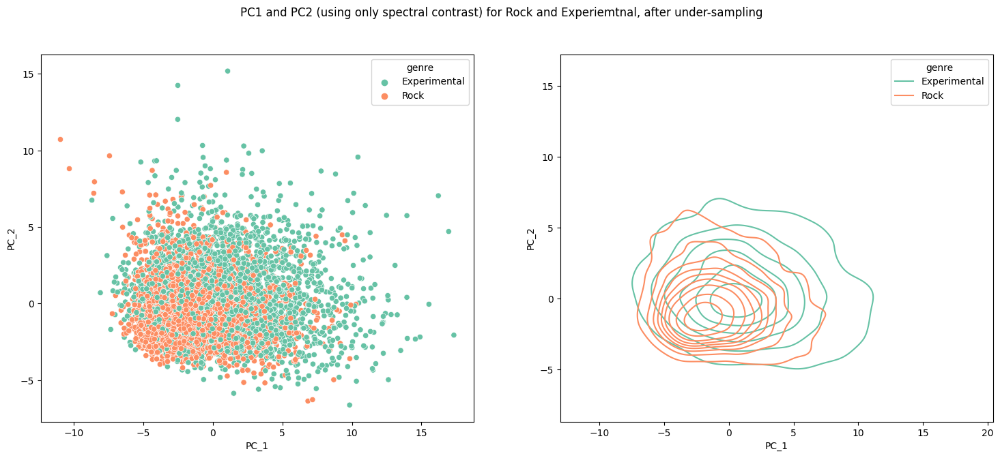

In [69]:
visualization.genre_2d_pca_visualization(train_set_modified, features=['spectral_contrast'], genres=['Rock', 'Experimental'], n_components=2, title='PC1 and PC2 (using only spectral contrast) for Rock and Experiemtnal, after under-sampling')

In [70]:
sm = SMOTE(
    sampling_strategy={
        'Hip-Hop' : 2500,
        'Folk' : 2000,
        'Instrumental' : 1800,
        'Pop': 1700,
        'International': 1000,
        'Classical': 1000,
        'Old-Time / Historic' : 600,
        'Jazz' : 600,
        'Spoken' : 200,
        'Soul-RnB' : 220,
        'Country' : 200,
        'Blues' : 200
    },
    random_state=123
)

In [71]:
train_set_modified.sort_index(inplace=True)

y = train_set_modified['genre'].copy()
X = train_set_modified.drop('genre', axis=1, inplace=False).copy()

C:\Users\User\AppData\Local\Temp\ipykernel_18344\2711905703.py:4: PerformanceWarning:

dropping on a non-lexsorted multi-index without a level parameter may impact performance.



In [72]:
X_res, y_res = sm.fit_resample(X, y)

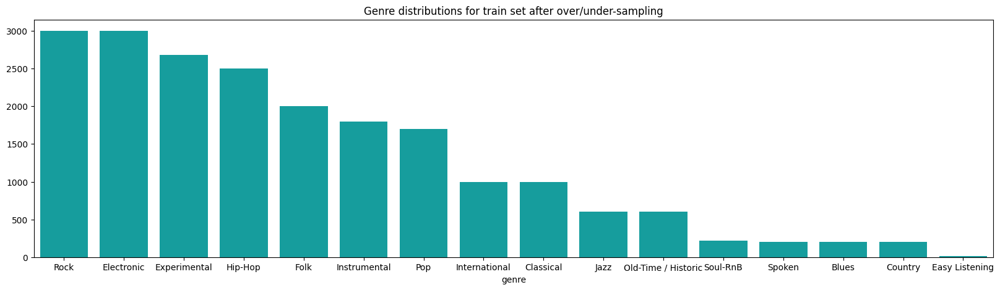

In [73]:
plt.figure(figsize=(20, 5))
sns.barplot(x=y_res.value_counts().index, y=y_res.value_counts().values, color='#00B3B3')
plt.title('Genre distributions for train set after over/under-sampling')
plt.show()

In [74]:
y_res = y_res.to_frame()
y_res.columns = pd.MultiIndex.from_tuples([('genre','','')])

In [75]:
train_set_modified = pd.merge(X_res, y_res, left_index=True, right_index=True, validate='1:1')
train_set_modified = train_set_modified.sort_index(axis=1)

In [76]:
train_set_modified.drop('popularity_score', axis=1, inplace=True)

In [77]:
train_set_modified.columns.get_level_values(0).unique()

Index(['chroma_cens', 'chroma_cqt', 'chroma_stft', 'genre', 'mfcc', 'rmse',
       'spectral_bandwidth', 'spectral_centroid', 'spectral_contrast',
       'spectral_rolloff', 'tonnetz', 'zcr'],
      dtype='object')

In [78]:
# Only for the visualization
df_modified_reduced_features = pd.concat([train_set_modified.loc[:, slice_1], train_set_modified.loc[:, slice_2]], axis=1).copy()

In [79]:
visualization.genre_3d_umap_visualization(
    df_modified_reduced_features, 
    label_column='genre',
    features=['mfcc', 'spectral_contrast'],
    n_components=3, n_neighbors=100, min_dist=0.2, metric='cosine',
    output_file='spectral_modified_100_02.html' 
)

# 5. Storing the processed data

In [80]:
print(f'          Train set original: {train_set.shape}')
print(f'Train set under/over-sampled: {train_set_modified.shape}')
print(f'              Validation set: {val_set.shape}')
print(f'                    Test set: {test_set.shape}')

          Train set original: (21572, 520)
Train set under/over-sampled: (20714, 519)
              Validation set: (2397, 519)
                    Test set: (5993, 519)


In [81]:
df.to_csv(os.getenv('FEATURES_PATH_PROCESSED'))
train_set.to_csv(os.getenv('TRAIN_SET_ORIGINAL_PATH'))
train_set_modified.to_csv(os.getenv('TRAIN_SET_MODIFIED_PATH'))
val_set.to_csv(os.getenv('VALIDATION_SET_PATH'))
test_set.to_csv(os.getenv('TEST_SET_PATH'))